Required Libraries

In [6]:
import pandas as pd
import matplotlib.pyplot as plt
import os

In [7]:
pip install tsfel

Note: you may need to restart the kernel to use updated packages.



[notice] A new release of pip is available: 24.0 -> 24.2
[notice] To update, run: python.exe -m pip install --upgrade pip


**Task 1**

Question 1

Plot the waveform for one sample data from each activity class. Are you able to see any difference/similarities between the activities? You can plot a subplot having 6 columns to show differences/similarities between the activities. Do you think the model will be able to classify the activities based on the data? 

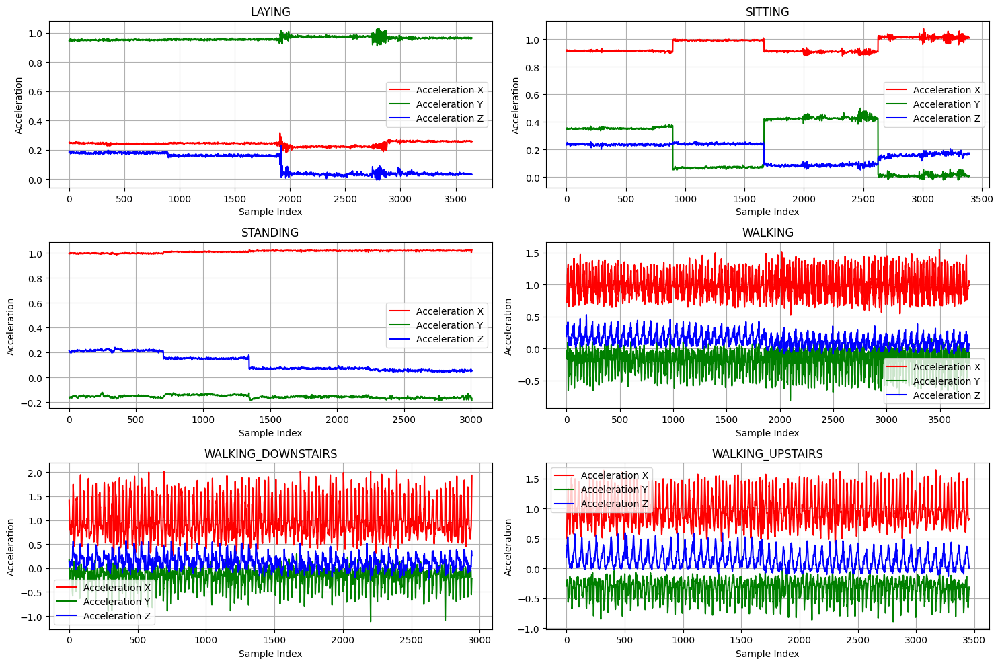

In [8]:

combined_dir = os.path.join("Combined")
dataset_dir = os.path.join(combined_dir,"Train")
folders = ["LAYING","SITTING","STANDING","WALKING","WALKING_DOWNSTAIRS","WALKING_UPSTAIRS"]

fig, axs = plt.subplots(3, 2, figsize=(15, 10))


i=0
for folder in folders:
    data = pd.read_csv(os.path.join(dataset_dir,folder,"Subject_11.csv"),sep=",",header=0)
    
    ax = axs[i // 2, i % 2]
    ax.plot(data.index, data['accx'], label='Acceleration X', color='r')
    ax.plot(data.index, data['accy'], label='Acceleration Y', color='g')
    ax.plot(data.index, data['accz'], label='Acceleration Z', color='b')
    
    ax.set_xlabel('Sample Index')
    ax.set_ylabel('Acceleration')
    ax.set_title(folder)
    ax.legend()
    ax.grid(True)
    i=i+1


plt.tight_layout()
plt.show()

There are similarities between laying, sitting and standing, considering that the accelaration in an axis tends to remain constant over periods of time. The are similarities between walking on level ground, upstairs, downstairs. Model would be able to predict the activities.

Question 2

Do you think we need a machine learning model to differentiate between static activities (laying, sitting, standing) and dynamic activities(walking, walking_downstairs, walking_upstairs)? Look at the linear acceleration 
(
a
c
c
x
2
+
a
c
c
y
2
+
a
c
c
z
2
)
 for each activity and justify your answer

Average magnitude squared for LAYING: 0.99
Average standard deviation for LAYING: 0.01
Average magnitude squared for SITTING: 1.04
Average standard deviation for SITTING: 0.02
Average magnitude squared for STANDING: 1.08
Average standard deviation for STANDING: 0.03
Average magnitude squared for WALKING: 1.16
Average standard deviation for WALKING: 0.52
Average magnitude squared for WALKING_DOWNSTAIRS: 1.20
Average standard deviation for WALKING_DOWNSTAIRS: 0.78
Average magnitude squared for WALKING_UPSTAIRS: 1.18
Average standard deviation for WALKING_UPSTAIRS: 0.56


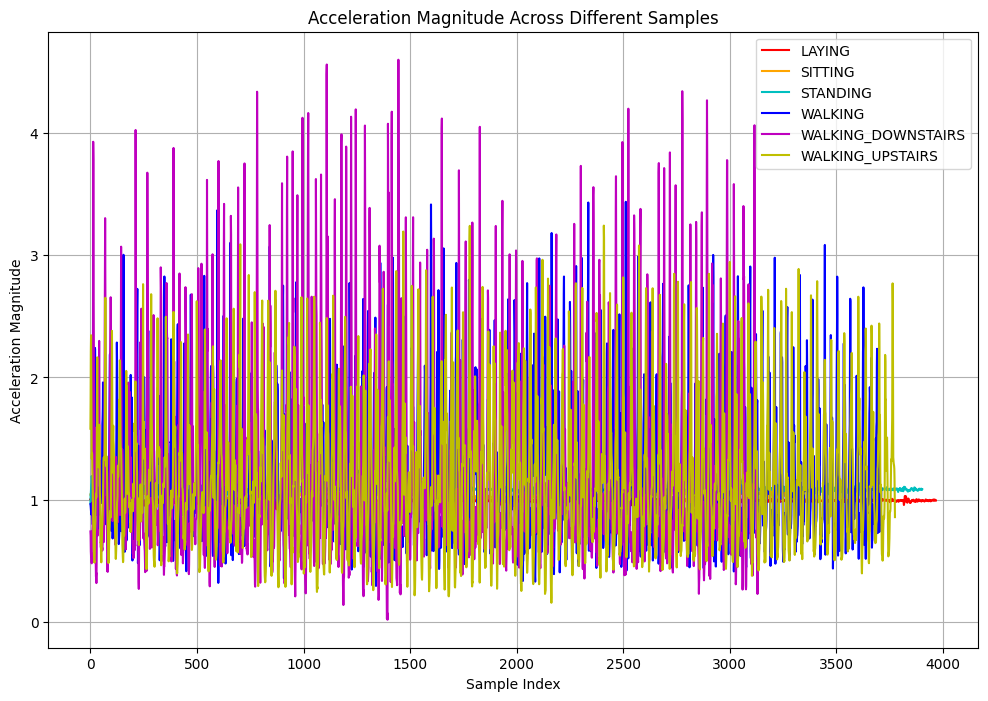

In [9]:
plt.figure(figsize=(12, 8))

colors = ['r', 'orange', 'c', 'b', 'm', 'y']

i=0
for folder in folders:
    data = pd.read_csv(os.path.join(dataset_dir,folder,"Subject_3.csv"),sep=",",header=0)
    acc_t=((data['accx'])**2 + (data['accy'])**2 + (data['accz'])**2)
    acc_t_mean=acc_t.mean()
    acc_t_std=acc_t.std()
    plt.plot(data.index, acc_t,label=folder, color=colors[i])
    i=i+1
    print(f'Average magnitude squared for {folder}: {acc_t_mean:.2f}')
    print(f'Average standard deviation for {folder}: {acc_t_std:.2f}')
plt.xlabel('Sample Index')
plt.ylabel('Acceleration Magnitude')
plt.title('Acceleration Magnitude Across Different Samples')
plt.legend()
plt.grid(True)

plt.show()

We can clearly observe the standard deviation for dynamic activities are much higher, and thus we dont need a machine learning model to differentiate between them.

Question 3

Use PCA (Principal Component Analysis) on Total Acceleration 
(
a
c
c
x
2
+
a
c
c
y
2
+
a
c
c
z
2
)
 to compress the acceleration timeseries into two features and plot a scatter plot to visualize different class of activities.

Shape of acceleration_data: (126, 500)


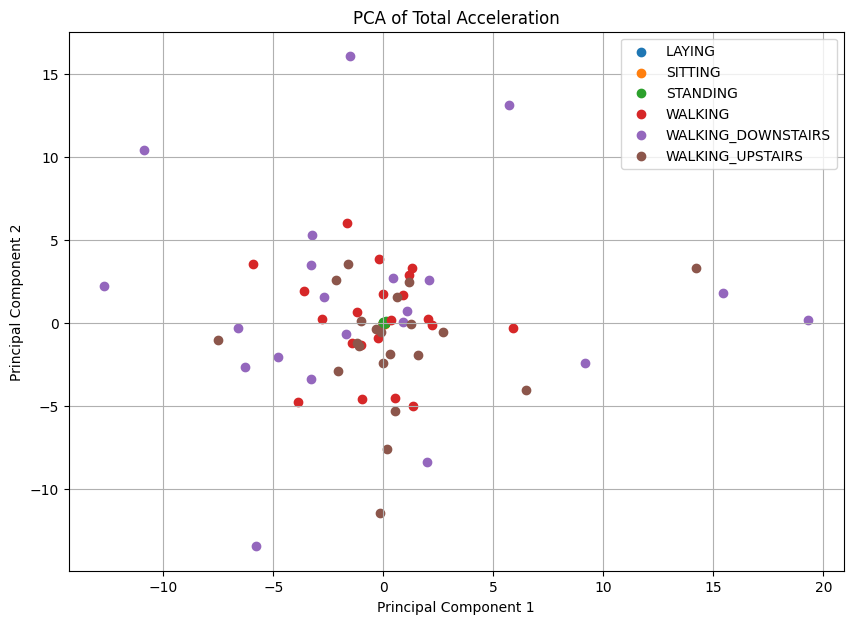

In [10]:
from sklearn.decomposition import PCA
import numpy as np

combined_dir = os.path.join("Combined")
dataset_dir = os.path.join(combined_dir,"Train")

activities = ['LAYING', 'SITTING', 'STANDING', 'WALKING', 'WALKING_DOWNSTAIRS', 'WALKING_UPSTAIRS']

acceleration_data = []
labels = []

for activity in activities:
    files = os.listdir(os.path.join(dataset_dir,activity))
    for file in files:
        file_path = os.path.join(dataset_dir, activity, file)
        data = pd.read_csv(file_path,sep=",",header=0)
        total_acceleration = (data['accx'])**2 + (data['accy'])**2 + (data['accz'])**2
        acceleration_data.append(total_acceleration[:500].to_numpy())
        labels += [activity]

acceleration_data = np.vstack(acceleration_data)
print("Shape of acceleration_data:", acceleration_data.shape)
pca = PCA(n_components=2)
principal_components = pca.fit_transform(acceleration_data)
labels = np.array(labels)
plt.figure(figsize=(10, 7))
for i, activity in enumerate(activities):
    plt.scatter(principal_components[labels == activity, 0], 
                principal_components[labels == activity, 1], 
                label=activity)
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.title('PCA of Total Acceleration')
plt.legend()
plt.grid(True)
plt.show()

Next, use TSFEL (a featurizer library) to create features (your choice which ones you feel are useful) and then perform PCA to obtain two features. Plot a scatter plot to visualize different class of activities.

*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
Shape of the combined features: (126, 1152)


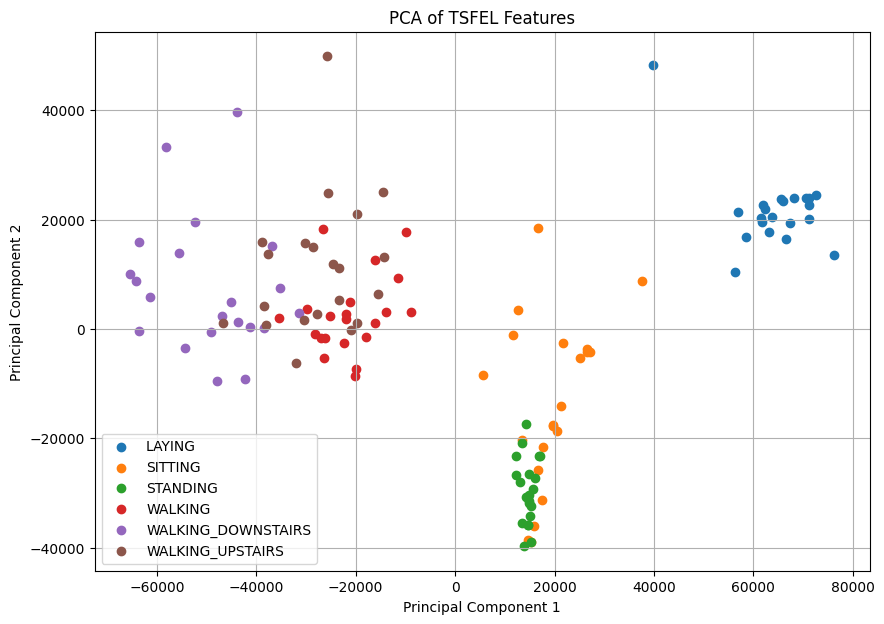

In [11]:
import tsfel

all_features = []
labels = []

for activity in activities:
    for file in files:
        file_path = os.path.join(dataset_dir, activity, file)
        data = pd.read_csv(file_path)
    
        data = data.iloc[:500]

        cfg = tsfel.get_features_by_domain() 
        features = tsfel.time_series_features_extractor(cfg, data, fs=50)

        all_features.append(features)
        labels.append(activity)

combined_features= pd.concat(all_features, ignore_index=True)

print(f"Shape of the combined features: {combined_features.shape}")

pca = PCA(n_components=2)
principal_components = pca.fit_transform(combined_features)

labels = np.array(labels)

plt.figure(figsize=(10, 7))
for activity in activities:
    plt.scatter(principal_components[labels == activity, 0], 
                principal_components[labels == activity, 1], 
                label=activity)
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.title('PCA of TSFEL Features')
plt.legend()
plt.grid(True)
plt.show()

Now use the features provided by the dataset and perform PCA to obtain two features. Plot a scatter plot to visualize different class of activities.

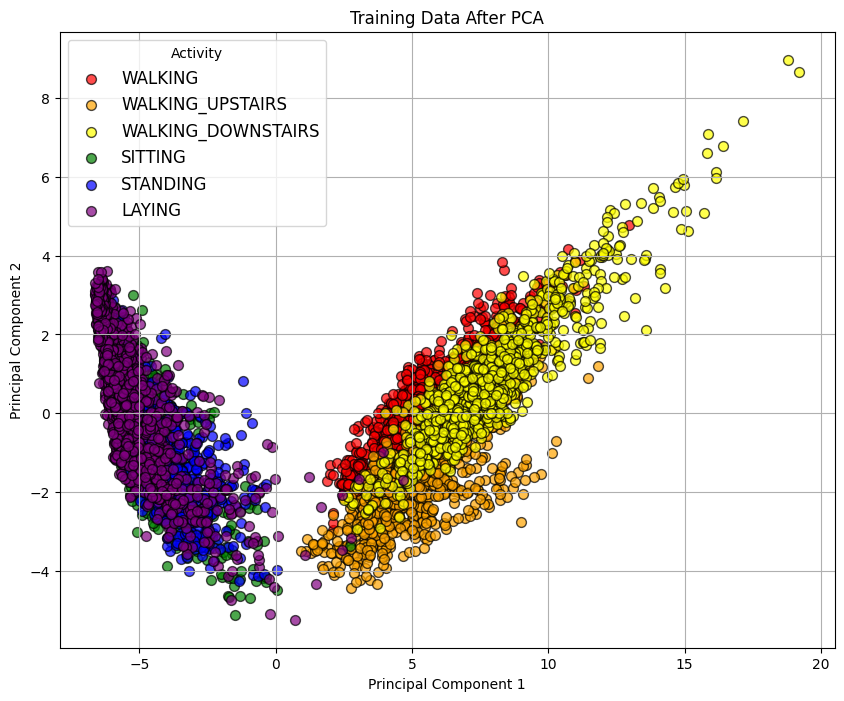

In [12]:
X_train = pd.read_csv(os.path.join("UCI HAR Dataset","UCI HAR Dataset","train","X_train.txt"), sep=r'\s+', header=None)
y_train = pd.read_csv(os.path.join("UCI HAR Dataset","UCI HAR Dataset","train","y_train.txt"), sep=r'\s+', header=None)
features_path=os.path.join("UCI HAR Dataset","UCI HAR Dataset","features.txt")
featuresdata=pd.read_csv(features_path,delim_whitespace=True,header=None)
featureslabels=featuresdata[1].values

X_train.columns=featureslabels

pca = PCA(n_components=2)
X_train_pca = pca.fit_transform(X_train)

df_train = pd.DataFrame(X_train_pca, columns=["PC1", "PC2"])
df_train["Activity"] = y_train
df_train["Activity"] = df_train["Activity"].map({1: "WALKING", 2: "WALKING_UPSTAIRS", 3: "WALKING_DOWNSTAIRS", 4: "SITTING", 5: "STANDING", 6: "LAYING"})

plt.figure(figsize=(10, 8))

colors = {
    "WALKING": "red",
    "WALKING_UPSTAIRS": "orange",
    "WALKING_DOWNSTAIRS": "yellow",
    "SITTING": "green",
    "STANDING": "blue",
    "LAYING": "purple"
}

for activity, color in colors.items():
    plt.scatter(
        df_train.loc[df_train["Activity"] == activity, "PC1"],
        df_train.loc[df_train["Activity"] == activity, "PC2"],
        c=color, label=activity, s=50, alpha=0.7, edgecolors='k'
    )

plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.title('Training Data After PCA')
plt.legend(title='Activity', fontsize=12)
plt.grid(True)
plt.show()

Compare the results of PCA on Total Acceleration, TSFEL and the dataset features. Which method do you think is better for visualizing the data?

Model Using Tsfel featuresis better for visualizing the data

Question 4

Calculate the correlation matrix of the features obtained by TSFEL and provided in the dataset. Identify the features that are highly correlated with each other. Are there any redundant features?

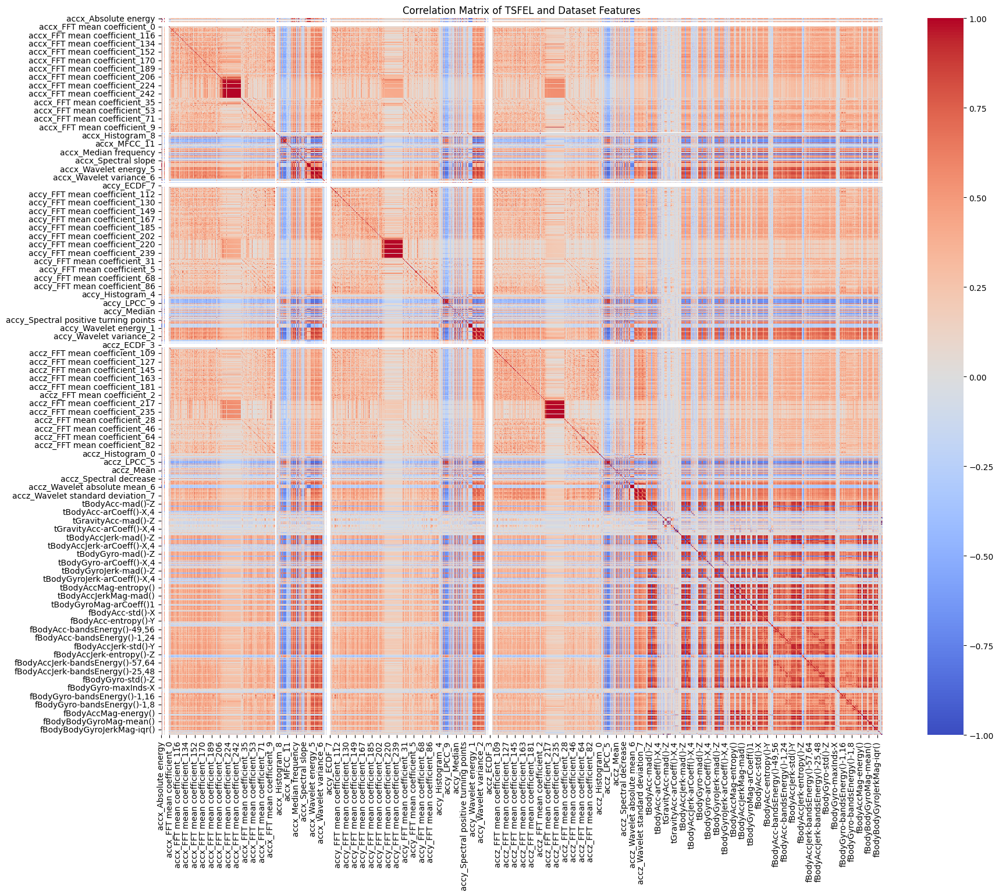

Highly correlated features: accx_Average power and accx_Absolute energy with correlation 1.00
Highly correlated features: accx_FFT mean coefficient_216 and accx_FFT mean coefficient_214 with correlation 1.00
Highly correlated features: accx_FFT mean coefficient_217 and accx_FFT mean coefficient_214 with correlation 1.00
Highly correlated features: accx_FFT mean coefficient_217 and accx_FFT mean coefficient_216 with correlation 1.00
Highly correlated features: accx_FFT mean coefficient_218 and accx_FFT mean coefficient_214 with correlation 1.00
Highly correlated features: accx_FFT mean coefficient_218 and accx_FFT mean coefficient_216 with correlation 1.00
Highly correlated features: accx_FFT mean coefficient_218 and accx_FFT mean coefficient_217 with correlation 1.00
Highly correlated features: accx_FFT mean coefficient_219 and accx_FFT mean coefficient_214 with correlation 0.99
Highly correlated features: accx_FFT mean coefficient_219 and accx_FFT mean coefficient_216 with correlation

In [13]:
import seaborn as sns

combined_feature = pd.concat([combined_features, X_train], axis=1)
correlation_matrix = combined_feature.corr()

plt.figure(figsize=(20, 16))
sns.heatmap(correlation_matrix, annot=False, cmap='coolwarm', vmin=-1, vmax=1)
plt.title('Correlation Matrix of TSFEL and Dataset Features')
plt.show()

threshold_high= 0.99
threshold_low=0.05
redundant_pairs=[]
high_corr_pairs = []

for i in range(len(correlation_matrix.columns)):
    for j in range(i):
        if abs(correlation_matrix.iloc[i, j]) > threshold_high:
            high_corr_pairs.append((correlation_matrix.columns[i], correlation_matrix.columns[j], correlation_matrix.iloc[i, j]))
        if abs(correlation_matrix.iloc[i, j]) < threshold_low:
            redundant_pairs.append((correlation_matrix.columns[i], correlation_matrix.columns[j], correlation_matrix.iloc[i, j]))

for pair in high_corr_pairs:
    print(f"Highly correlated features: {pair[0]} and {pair[1]} with correlation {pair[2]:.2f}")
for pair in redundant_pairs:
    print(f"Redudant features: {pair[0]} and {pair[1]} with correlation {pair[2]:.2f}")

Task 2

In [14]:
import numpy as np
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import confusion_matrix,accuracy_score,precision_score,recall_score
import seaborn as sns 

ACTIVITIES = {
    1: 'WALKING'            ,
    2: 'WALKING_UPSTAIRS'   ,
    3: 'WALKING_DOWNSTAIRS' ,
    4: 'SITTING'            ,
    5: 'STANDING'           ,
    6: 'LAYING'             ,
}

accuracyval,precisionval,recallval=[],[],[]

Question 1

Train a decision tree model using the raw accelerometer data. Report the accuracy, precision, recall and confusion matrix of the model.

Training data shape:  (126, 500, 3)
Testing data shape:  (54, 500, 3)
Accuracy:61.111111111111114 %
Precision:56.1111111111111 %
Recall: 61.111111111111114 %


Text(77.92222222222226, 0.5, 'ACTUAL ACTIVITY')

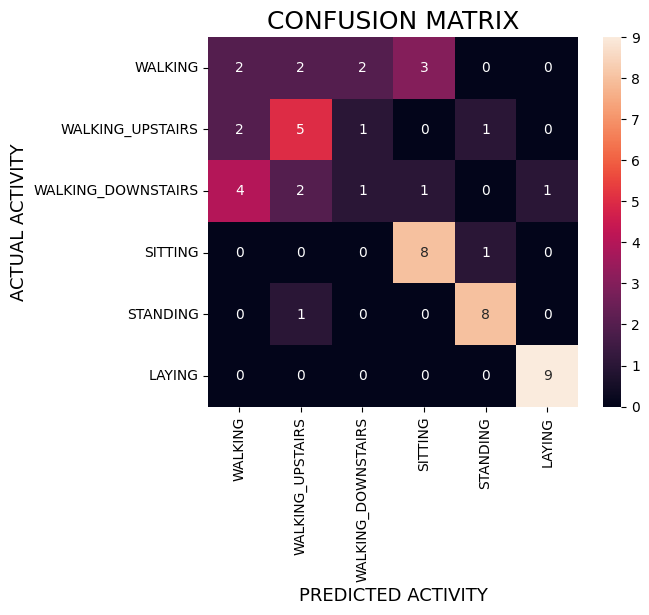

In [15]:
from MakeDataset import X_train,X_test,y_train,y_test

#importing data to train decision
X_train1,X_test1,y_train1,y_test1=X_train.copy(),X_test.copy(),y_train.copy(),y_test.copy()

tree=DecisionTreeClassifier(random_state=42)
tree.fit(X_train1.reshape(-1,500*3),y_train1)
y_pred1=tree.predict(X_test1.reshape(-1,500*3))

print(f"Accuracy:{accuracy_score(y_test1,y_pred1)*100} %")
accuracyval.append(accuracy_score(y_test1,y_pred1)*100)
print(f"Precision:{precision_score(y_test1,y_pred1,average="weighted")*100} %")
precisionval.append(precision_score(y_test1,y_pred1,average="weighted")*100)
print(f"Recall: {recall_score(y_test1,y_pred1,average="weighted")*100} %")
recallval.append(recall_score(y_test1,y_pred1,average="weighted"))

confusionmatrix=confusion_matrix(y_test1,y_pred1)
sns.heatmap(confusionmatrix,square=True,annot=True,xticklabels=ACTIVITIES.values(),yticklabels=ACTIVITIES.values())
plt.title("CONFUSION MATRIX",fontdict={"fontsize":18})
plt.xlabel("PREDICTED ACTIVITY",fontdict={"fontsize":13})
plt.ylabel("ACTUAL ACTIVITY",fontdict={"fontsize":13})


Train a decision tree model using the features obtained by TSFEL. Report the accuracy, precision, recall and confusion matrix of the model.

*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
Accuracy:88.88888888888889 %
Precision:89.36988936988936 %
Recall: 88.88888888888889 %


Text(77.92222222222226, 0.5, 'ACTUAL ACTIVITY')

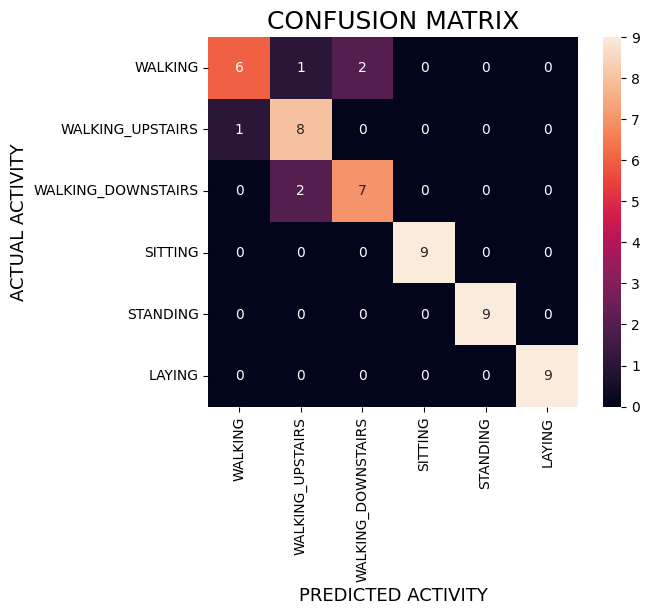

In [16]:
import tsfel
cfg = tsfel.get_features_by_domain()
x_train_dataset= pd.DataFrame(np.concatenate((X_train.reshape((-1, 3)), np.repeat(y_train, 500).reshape(-1,1)), axis = 1), columns = ["accx", "accy", "accz", "label"])
x_test_dataset= pd.DataFrame(np.concatenate((X_test.reshape((-1, 3)), np.repeat(y_test, 500).reshape(-1,1)), axis = 1), columns = ["accx", "accy", "accz", "label"])

X_train_tsfel = tsfel.time_series_features_extractor(cfg,x_train_dataset[['accx','accy','accz']],fs=50,window_size=500)
X_test_tsfel = tsfel.time_series_features_extractor(cfg,x_test_dataset[['accx','accy','accz']],fs=50,window_size=500)

X_train2=np.array(X_train_tsfel.iloc[:,:])
X_test2=np.array(X_test_tsfel.iloc[:,:])

tree2=DecisionTreeClassifier(random_state=42)
tree2.fit(X_train2,y_train1)
y_pred2=tree2.predict(X_test2)

print(f"Accuracy:{accuracy_score(y_test1,y_pred2)*100} %")
accuracyval.append(accuracy_score(y_test1,y_pred2)*100)
print(f"Precision:{precision_score(y_test1,y_pred2,average="weighted")*100} %")
precisionval.append(precision_score(y_test1,y_pred2,average="weighted")*100)
print(f"Recall: {recall_score(y_test1,y_pred2,average="weighted")*100} %")
recallval.append(recall_score(y_test1,y_pred2,average="weighted"))

confusionmatrix=confusion_matrix(y_test,y_pred2)
sns.heatmap(confusionmatrix,square=True,annot=True,xticklabels=ACTIVITIES.values(),yticklabels=ACTIVITIES.values())
plt.title("CONFUSION MATRIX",fontdict={"fontsize":18})
plt.xlabel("PREDICTED ACTIVITY",fontdict={"fontsize":13})
plt.ylabel("ACTUAL ACTIVITY",fontdict={"fontsize":13})


Train a decision tree model using the features provided in the dataset. Report the accuracy, precision, recall and confusion matrix of the model.

Training data shape:  (126, 30, 561)
Testing data shape:  (54, 30, 561)
Accuracy:88.88888888888889 %
Precision:89.21296296296296 %
Recall: 88.88888888888889 %


Text(77.92222222222226, 0.5, 'ACTUAL ACTIVITY')

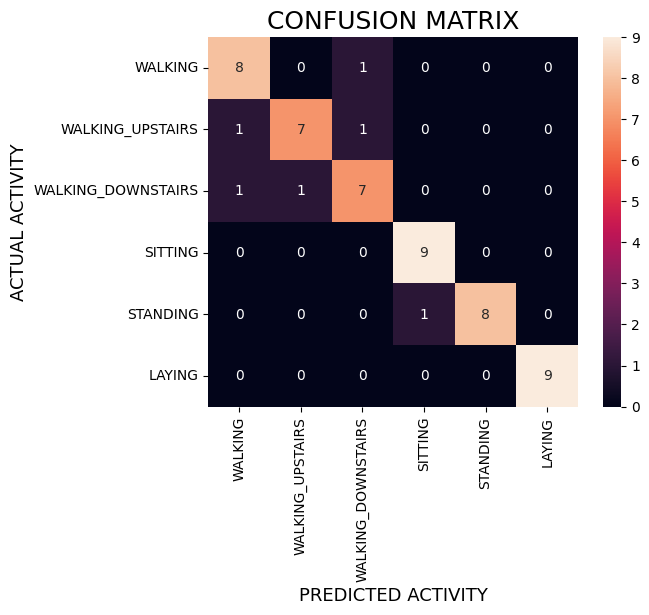

In [17]:
from MakeDataset2 import X_train,X_test,y_train,y_test

X_train3,X_test3,y_train3,y_test3=X_train.copy(),X_test.copy(),y_train.copy(),y_test.copy()

tree3=DecisionTreeClassifier(random_state=42)
tree3.fit(X_train3.reshape(-1,30*561),y_train3)
y_pred3=tree3.predict(X_test3.reshape(-1,30*561))

print(f"Accuracy:{accuracy_score(y_test3,y_pred3)*100} %")
accuracyval.append(accuracy_score(y_test3,y_pred3)*100)
print(f"Precision:{precision_score(y_test3,y_pred3,average="weighted")*100} %")
precisionval.append(precision_score(y_test3,y_pred3,average="weighted")*100)
print(f"Recall: {recall_score(y_test3,y_pred3,average="weighted")*100} %")
recallval.append(recall_score(y_test3,y_pred3,average="weighted"))

confusionmatrix=confusion_matrix(y_test3,y_pred3)
sns.heatmap(confusionmatrix,square=True,annot=True,xticklabels=ACTIVITIES.values(),yticklabels=ACTIVITIES.values())
plt.title("CONFUSION MATRIX",fontdict={"fontsize":18})
plt.xlabel("PREDICTED ACTIVITY",fontdict={"fontsize":13})
plt.ylabel("ACTUAL ACTIVITY",fontdict={"fontsize":13})

Compare the results of the three models. Which model do you think is better?

In [18]:
result={
    "Accuracy":accuracyval,
    "Precision":precisionval,
    "Recall":recallval
}

resultdata=pd.DataFrame(result,index=["Using Raw Data","Using Tsfel features","Using Other Features"])
resultdata

,Accuracy,Precision,Recall
Using Raw Data,61.111111,56.111111,0.611111
Using Tsfel features,88.888889,89.369889,0.888889
Using Other Features,88.888889,89.212963,0.888889


Model using Tsfel features because Precision for Model using Tsfel features is comparatively more than other models.

Question 2

Train Decision Tree with varying depths (2-8) using all above 3 methods. Plot the accuracy of the model on test data vs the depth of the tree

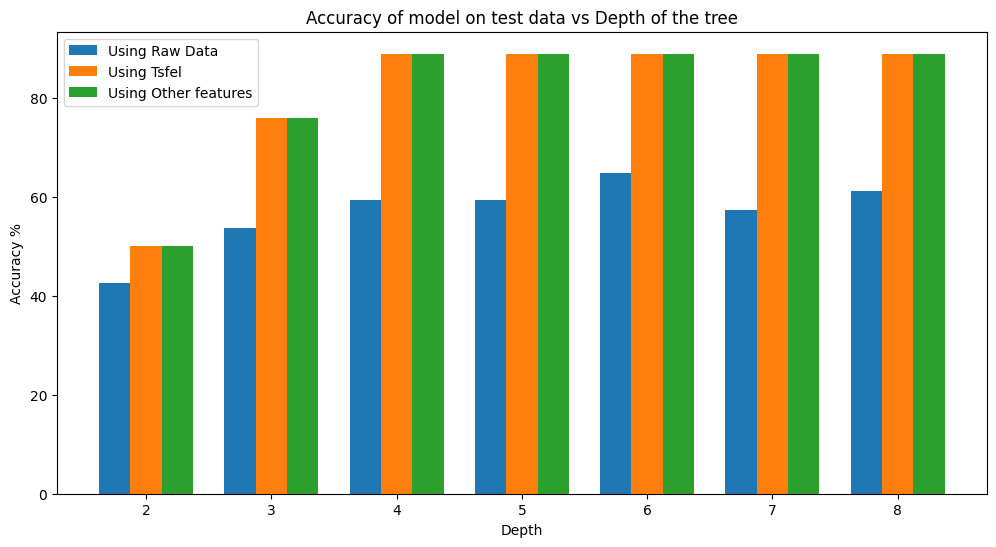

In [19]:
accval1=[]
accval2=[]
accval3=[]

for i in range(2,9):
    tree1=DecisionTreeClassifier(random_state=42,max_depth=i)
    tree1.fit(X_train1.reshape(-1,500*3),y_train1)
    y_pred1=tree1.predict(X_test1.reshape(-1,500*3))
    accval1.append(accuracy_score(y_test1,y_pred1)*100)

    tree2=DecisionTreeClassifier(random_state=42,max_depth=i)
    tree2.fit(X_train2,y_train1)
    y_pred2=tree2.predict(X_test2)
    accval2.append(accuracy_score(y_test1,y_pred2)*100)

    tree3=DecisionTreeClassifier(random_state=42,max_depth=i)
    tree3.fit(X_train3.reshape(-1,30*561),y_train3)
    y_pred3=tree3.predict(X_test3.reshape(-1,30*561))
    accval3.append(accuracy_score(y_test3,y_pred3)*100)

l1=[i for i in range(2,9)]
l2=[i+0.25 for i in range(2,9)]
l3=[i+0.5 for i in range(2,9)]

barwidth=0.25

plt.figure(figsize=(12, 6))

plt.bar(l1,accval1,width=barwidth,label="Using Raw Data")
plt.bar(l2,accval2,width=barwidth,label="Using Tsfel")
plt.bar(l3,accval2,width=barwidth,label="Using Other features")

plt.title("Accuracy of model on test data vs Depth of the tree")
plt.xlabel("Depth")
plt.ylabel("Accuracy %")
label=[i for i in range(2,9)]

plt.xticks(l2, label)
plt.legend()

Are there any participants/ activitivies where the Model performace is bad? If Yes, Why? [0.5 mark]

Model performance is bad for Laying Activity because the accuracy for all 3 models is comparatively less for Laying than for other acitivities

Task 3

In [34]:
from sklearn.preprocessing import StandardScaler
import tsfel

from MakeDataset import X_train, y_train, X_test, y_test

def df_features_pca(X, y): # Creating a function to get PCA dataframe of featurized acclerometer data.
    
    df = pd.DataFrame(np.concatenate((X.reshape((-1, 3)), np.repeat(y, 500).reshape(-1,1)), axis = 1), columns = ["a_x", "a_y", "a_z", "label"])


    # Getting features
    cfg_file = tsfel.get_features_by_domain()                                                        # If no argument is passed retrieves all available features
    tsfel_df = tsfel.time_series_features_extractor(cfg_file, df[["a_x", "a_y", "a_z"]], fs=50, window_size=500)    # Receives a time series sampled at 50 Hz, divides into windows of size 500 (i.e. 10 seconds) and extracts all features
    tsfel_df

    # Getting PCA's
    scaler = StandardScaler()
    tsfel_df_scaled = scaler.fit_transform(tsfel_df)

    n_components = 7
    pca = PCA(n_components)  
    tsfel_df_pca = pca.fit_transform(tsfel_df_scaled)

    # Create a DataFrame with the PCA results
    pca_df = pd.DataFrame(data=tsfel_df_pca, columns=[f"Principle Component {i}" for i in range(1, n_components+1)])

    
    # Adding labels to the data
    pca_df["Numbered Label"] = y
    mapping = {1: "Walking", 2 : "Walking-Upstairs", 3: "Walking-Downstairs",4: "Sitting", 5: "Standing", 6: "Laying"}
    pca_df['Actual Label'] = pca_df['Numbered Label'].map(mapping)
    pca_df.drop("Numbered Label", axis = 1, inplace = True)
    
    return pca_df


df_test = df_features_pca(X_test, y_test)
df_train = df_features_pca(X_train, y_train)

*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***


#### 1. Demonstrate how to use Zero-Shot Learning and Few-Shot Learning to classify human activities based on the featurized accelerometer data. Qualitatively demonstrate the performance of Few-Shot Learning with Zero-Shot Learning. Which method performs better? Why? [1 marks]

In [35]:
pip install langchain_groq

Note: you may need to restart the kernel to use updated packages.



[notice] A new release of pip is available: 24.0 -> 24.2
[notice] To update, run: python.exe -m pip install --upgrade pip


In [36]:
from langchain_groq.chat_models import ChatGroq
# Groq API and Models 
Groq_Token = "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"  

groq_models = {"llama3-70b": "llama3-70b-8192", "mixtral": "mixtral-8x7b-32768", "gemma-7b": "gemma-7b-it","llama3.1-70b":"llama-3.1-70b-versatile","llama3-8b":"llama3-8b-8192","llama3.1-8b":"llama-3.1-8b-instant","gemma-9b":"gemma2-9b-it"}

In [39]:
import json
import time

data = df_test.drop("Actual Label", axis = 1).to_json(orient="records")
zero_shot_predictions = []


for i in range(len(eval(data))):
    query = f"""
    * You are a Human Activity Recognition analysis model
    * You will be given Principle Components of features extrated from a time series data of acclerations in the Cartesian x, y, z directions obtained by perfomring different activities.
    * Your task is to classify activity as "Walking", "Walking-Upstairs", "Walking-Downstairs", "Sitting", "Standing", "Laying".
    * Provide ONLY predicted label.

    Here is the data:
    {eval(data)[i]}


    """ 

    # To use Groq LLMs 
    model_name = "llama3-70b" # We can choose any model from the groq_models dictionary
    llm = ChatGroq(model=groq_models[model_name], api_key=Groq_Token, temperature=0)
    answer_zero_shot = llm.invoke(query)

    zero_shot_predictions.append(answer_zero_shot.content)


Error on attempt 1: Error code: 503 - {'error': {'message': 'Service Unavailable', 'type': 'internal_server_error'}}
Error on attempt 1: Error code: 503 - {'error': {'message': 'Service Unavailable', 'type': 'internal_server_error'}}
Error on attempt 1: Error code: 503 - {'error': {'message': 'Service Unavailable', 'type': 'internal_server_error'}}


In [ ]:
labeled_data = df_train
data = df_test.drop("Actual Label", axis = 1).to_json(orient="records")
few_shot_predictions = []

for i in range(len(eval(data))):
    
    query = f"""
    * You are a Human Activity Recognition analysis model
    * You will be given Principle Components of features extrated from a time series data of acclerations in the Cartesian x, y, z directions obtained by perfomring different activities as labeled data.
    * Each line of the labeled data represents principle components for an activity.
    * Your task is to classify activity as "Walking", "Walking-Upstairs", "Walking-Downstairs", "Sitting", "Standing", "Laying" only.
    * Provide ONLY a predicted label.

    Here is the labeled data:
    {labeled_data}
        

    Here is the data to predict on:
    {eval(data)[i]}

    """ 

    # To use Groq LLMs 
    model_name = "llama3-70b" # We can choose any model from the groq_models dictionary
    llm = ChatGroq(model=groq_models[model_name], api_key=Groq_Token, temperature=0)
    answer_few_shot = llm.invoke(query)

    few_shot_predictions.append(answer_few_shot.content)

#### While submitting this file, getting the Few-Shot predicitons gave Server error, this also had implications on upcoming tasks. Therfore submitting this file as it is with upcoming tasks with previous outputs which go without major change in current code. Changes are also metioned.

In [ ]:
df_ana = pd.DataFrame({"Zero-Shot Labels": zero_shot_predictions, "Few-Shot Labels": few_shot_predictions, "Actual Labels": df_test["Actual Label"]})

In [ ]:
df_ana

In [ ]:
a = sum(df_ana["Zero-Shot Labels"] == df_ana["Actual Labels"])
a = (a/len(eval(data)))*100
print(f"Acuraccy of Zero-Shot Learning is {round(a, 2)}%.")

b = sum(df_ana["Few-Shot Labels"] == df_ana["Actual Labels"])
b = (b/len(eval(data)))*100
print(f"Acuraccy of Few-Shot Learning is {round(b, 2)}%.")

#### Below changes were made for displaying the confusion matrix.

In [ ]:
labels = ['Walking', 'Walking-Upstairs', 'Walking-Downstairs', 'Sitting', 'Standing', 'Laying']
cm = confusion_matrix(df_ana["Actual Labels"], df_ana["Few-Shot Labels"], labels = labels)
cm_df = pd.DataFrame(cm, index=labels, columns=labels)
print("Confusion Matrix for Few-Shot learning:")
print(cm_df)

In [ ]:
cm = confusion_matrix(df_ana["Actual Labels"], df_ana["Zero-Shot Labels"], label = labels)
cm_df = pd.DataFrame(cm, index=labels, columns=labels)
print("Confusion Matrix for Zero-Shot learning:")
print(cm_df)

##### As expected the accuracy of Zero-Shot learning comes out to be less than Few-Shot learning reason being in Few-Shot learning we gave the LLM labeled to learn upon.

#### 2. Quantitatively compare the accuracy of Few-Shot Learning with Decision Trees (You may use a subset of the test set if you encounter rate-limiting issues). Which method performs better? Why? [1 marks]

In [ ]:
from sklearn.tree import DecisionTreeClassifier
# Training the Desicion Tree model
clf = DecisionTreeClassifier()
clf.fit(df_train.iloc[:, 0:7], df_train.iloc[:, 7])

# Predictions
y_pred = clf.predict(df_test.drop("Actual Label", axis = 1))

# Getting the accuracy
from sklearn.metrics import accuracy_score
accuracy = accuracy_score(df_test["Actual Label"], y_pred)

# Comparing accuracies
print(f"Accuracy of the Disicion Tree model on the featurized accelorometer data is {accuracy * 100}%.")
print(f"Accuracy of the Few-Shot learning model on the featurized acclerometer data is {b}%.")

##### Desicion Tree model performs better than Few-Shot lerning. Because Decision trees can perform well on data with structure and containing clear patters where as Few-Shot lerning relys on an LLM model which perform well on textual data rather than non-textual data like dataframes. Decision tree are very specific in learning rules form data, whereas Few-Shot learning is good at genralization.

#### 3. What are the limitations of Zero-Shot Learning and Few-Shot Learning in the context of classifying human activities based on featurized accelerometer data? [1 marks]

##### First limitation being the token limit. Which in our case for LLaMA 3 70B model is 100k tokens, output and input combined. In context of classifying human activites we need large amount of data as differnce in anatomy results in differnce in movement hence differnce in data, if we can't feed enough data to our model its acuraccy would obviously low. Zero-Shot learning had a poor acuraccy predicting the unseen data. Few-Shot learning is suited of limited labeled data, this causes poor genralization when given data with multiple features and variablity.

#### 4. What does the model classify when given input from an entirely new activity that it hasn't seen before? [0.5 mark]


##### Training data without the activity 'Waliking-Upstairs', which is a dynamic activity.

In [ ]:
labeled_data = df_train[df_train["Actual Label"] != "Walking-Upstairs"]
data = df_test[df_test["Actual Label"] == "Walking-Upstairs"].drop("Actual Label", axis = 1).to_json(orient="records")
unknown_predictions = []

for i in range(len(eval(data))):
    query = f"""
    * You are a Human Activity Recognition analysis model
    * You will be given Principle Components of features extrated from a time series data of acclerations in the Cartesian x, y, z directions obtained by perfomring different activities as labeled data.
    * Each line of the labeled data represents principle components for an activity.
    * Your task is to classify activity as "Walking", "Walking-Upstairs", "Walking-Downstairs", "Sitting", "Standing", "Laying" only.
    * Provide ONLY a predicted label.

    Here is the labeled data:
    {labeled_data}
        

    Here is the data to predict on:
    {eval(data)[i]}

    """ 

    # To use Groq LLMs 
    model_name = "llama3-70b" # We can choose any model from the groq_models dictionary
    llm = ChatGroq(model=groq_models[model_name], api_key=Groq_Token, temperature=0)
    answer_few_shot = llm.invoke(query)

    unknown_predictions.append(answer_few_shot.content)

In [ ]:
unknown_predictions

##### Our model's accuracy for predicting the activity 'Waliking-Upstairs' is ZERO. But it is correctly predicting it as a dynamic activity with an accuracy of 88 %.

##### Training data without the activity 'Standing', which is a static activity:

In [ ]:
labeled_data = df_train[df_train["Actual Label"] != "Standing"]
data = df_test[df_test["Actual Label"] == "Standing"].drop("Actual Label", axis = 1).to_json(orient="records")
unknown_predictions = []

for i in range(len(eval(data))):
    query = f"""
    * You are a Human Activity Recognition analysis model
    * You will be given Principle Components of features extrated from a time series data of acclerations in the Cartesian x, y, z directions obtained by perfomring different activities as labeled data.
    * Each line of the labeled data represents principle components for an activity.
    * Your task is to classify activity as "Walking", "Walking-Upstairs", "Walking-Downstairs", "Sitting", "Standing", "Laying" only.
    * Provide ONLY a predicted label.

    Here is the labeled data:
    {labeled_data}
        

    Here is the data to predict on:
    {eval(data)[i]}

    """ 

    # To use Groq LLMs 
    model_name = "llama3-70b" # We can choose any model from the groq_models dictionary
    llm = ChatGroq(model=groq_models[model_name], api_key=Groq_Token, temperature=0)
    answer_few_shot = llm.invoke(query)

    unknown_predictions.append(answer_few_shot.content)

In [ ]:
unknown_predictions

##### Our model's accuracy for predicting the activity 'Standing' is 22%. Also its accuracy for predicting a static activity as static is 100%.

### 5. Test the model with random data (ensuring the data has the same dimensions and range as the previous input) and report the results. [0.5 mark]

In [ ]:
random_data_shape = X_test.shape
random_data_max = X_test.max()
random_data_min = X_test.min()

random_data = np.random.uniform(random_data_min, random_data_max, size=random_data_shape)

random_df = pd.DataFrame(random_data.reshape((-1, 3)), columns = ["a_x", "a_y", "a_z"])


# Getting features
cfg_file = tsfel.get_features_by_domain()                                                        # If no argument is passed retrieves all available features
tsfel_df = tsfel.time_series_features_extractor(cfg_file, random_df[["a_x", "a_y", "a_z"]], fs=50, window_size=500)    # Receives a time series sampled at 50 Hz, divides into windows of size 500 (i.e. 10 seconds) and extracts all features
tsfel_df

# Getting PCA's
scaler = StandardScaler()
tsfel_df_scaled = scaler.fit_transform(tsfel_df)

n_components = 7
pca = PCA(n_components)  
tsfel_df_pca = pca.fit_transform(tsfel_df_scaled)

# Create a DataFrame with the PCA results
random_df_test = pd.DataFrame(data=tsfel_df_pca, columns=[f"Principle Component {i}" for i in range(1, n_components+1)])


In [ ]:
labeled_data = df_train
data = random_df_test.to_json(orient="records")
few_shot_predictions = []

for i in range(len(eval(data))):
    query = f"""
    * You are a Human Activity Recognition analysis model
    * You will be given Principle Components of features extrated from a time series data of acclerations in the Cartesian x, y, z directions obtained by perfomring different activities as labeled data.
    * Each line of the labeled data represents principle components for an activity.
    * Your task is to classify activity as "Walking", "Walking-Upstairs", "Walking-Downstairs", "Sitting", "Standing", "Laying" only.
    * Provide ONLY a predicted label.

    Here is the labeled data:
    {labeled_data}
        

    Here is the data to predict on:
    {eval(data)[i]}

    """ 

    # To use Groq LLMs 
    model_name = "llama3-70b" # We can choose any model from the groq_models dictionary
    llm = ChatGroq(model=groq_models[model_name], api_key=Groq_Token, temperature=0)
    answer_few_shot = llm.invoke(query)

    few_shot_predictions.append(answer_few_shot.content)

In [ ]:
df_ana = pd.DataFrame({ "Few-Shot Labels": few_shot_predictions})
df_ana

In [ ]:
df_ana["Few-Shot Labels"].value_counts()

##### On observing the predictions the model is predicting the random activity data mostly as static activites.

Task 4

Use the Decision Tree model trained on the UCI-HAR dataset to predict the activities that you performed. Report the accuracy, precision, recall and confusion matrix of the model. You have three version of UCI dataset you can use a)Raw data from accelerometer, b)TSFEL featurised data, c)Features provided by author. Choose which version to use, ensuring that your test data is similar to your training data. How did the model perform?

Accuracy:16.666666666666664 %
Precision:3.333333333333334 %
Recall: 16.666666666666664 %


c:\Users\Sarvesh\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\metrics\_classification.py:1471: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\Users\Sarvesh\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\metrics\_classification.py:1471: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Text(77.92222222222226, 0.5, 'ACTUAL ACTIVITY')

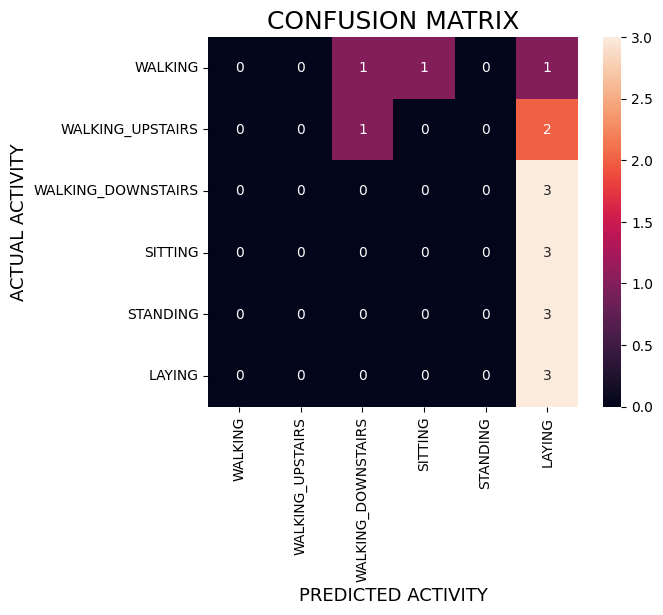

In [28]:
from MakeDataset import X_train,y_train
from MakeDataset3 import X,y

X_train1,y_train1=X_train.copy(),y_train.copy()
X_test1,y_test1=X.copy(),y.copy()

tree=DecisionTreeClassifier(random_state=42)
tree.fit(X_train1.reshape(-1,500*3),y_train1)
y_pred1=tree.predict(X_test1.reshape(-1,500*3))

print(f"Accuracy:{accuracy_score(y_test1,y_pred1)*100} %")
accuracyval.append(accuracy_score(y_test1,y_pred1)*100)
print(f"Precision:{precision_score(y_test1,y_pred1,average="weighted")*100} %")
precisionval.append(precision_score(y_test1,y_pred1,average="weighted")*100)
print(f"Recall: {recall_score(y_test1,y_pred1,average="weighted")*100} %")
recallval.append(recall_score(y_test1,y_pred1,average="weighted"))

confusionmatrix=confusion_matrix(y_test1,y_pred1)
sns.heatmap(confusionmatrix,square=True,annot=True,xticklabels=ACTIVITIES.values(),yticklabels=ACTIVITIES.values())
plt.title("CONFUSION MATRIX",fontdict={"fontsize":18})
plt.xlabel("PREDICTED ACTIVITY",fontdict={"fontsize":13})
plt.ylabel("ACTUAL ACTIVITY",fontdict={"fontsize":13})


Model failed because of less number of samples.

*** Feature extraction started ***



*** Feature extraction finished ***
*** Feature extraction started ***



*** Feature extraction finished ***
Accuracy:16.666666666666664 %
Precision:3.125 %
Recall: 16.666666666666664 %


c:\Users\Sarvesh\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\metrics\_classification.py:1471: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\Users\Sarvesh\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\metrics\_classification.py:1471: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Text(77.92222222222226, 0.5, 'ACTUAL ACTIVITY')

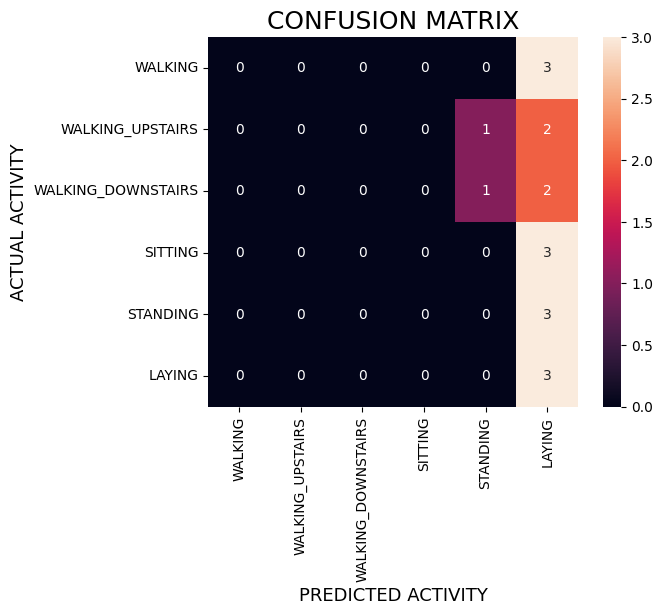

In [20]:
from MakeDataset import X_train,y_train
from MakeDataset3 import X,y

import tsfel
cfg = tsfel.get_features_by_domain()
x_train_dataset= pd.DataFrame(np.concatenate((X_train.reshape((-1, 3)), np.repeat(y_train, 500).reshape(-1,1)), axis = 1), columns = ["accx", "accy", "accz", "label"])
x_test_dataset= pd.DataFrame(np.concatenate((X.reshape((-1, 3)), np.repeat(y, 500).reshape(-1,1)), axis = 1), columns = ["accx", "accy", "accz", "label"])

X_train_tsfel = tsfel.time_series_features_extractor(cfg,x_train_dataset[['accx','accy','accz']],fs=50,window_size=500)
X_test_tsfel = tsfel.time_series_features_extractor(cfg,x_test_dataset[['accx','accy','accz']],fs=50,window_size=500)

X_train2=np.array(X_train_tsfel.iloc[:,:])
X_test2=np.array(X_test_tsfel.iloc[:,:])

tree2=DecisionTreeClassifier(random_state=42)
tree2.fit(X_train2,y_train1)
y_pred2=tree2.predict(X_test2)

print(f"Accuracy:{accuracy_score(y,y_pred2)*100} %")
accuracyval.append(accuracy_score(y,y_pred2)*100)
print(f"Precision:{precision_score(y,y_pred2,average="weighted")*100} %")
precisionval.append(precision_score(y,y_pred2,average="weighted")*100)
print(f"Recall: {recall_score(y,y_pred2,average="weighted")*100} %")
recallval.append(recall_score(y,y_pred2,average="weighted"))

confusionmatrix=confusion_matrix(y,y_pred2)
sns.heatmap(confusionmatrix,square=True,annot=True,xticklabels=ACTIVITIES.values(),yticklabels=ACTIVITIES.values())
plt.title("CONFUSION MATRIX",fontdict={"fontsize":18})
plt.xlabel("PREDICTED ACTIVITY",fontdict={"fontsize":13})
plt.ylabel("ACTUAL ACTIVITY",fontdict={"fontsize":13})


Model failed because of less number of samples

Use the data you collected to predict the activities that you performed. Decide whether to apply preprocessing and featurization, and if so, choose the appropriate methods. How did the model perform? 

Yes data obtained has to be preprocessed and featured using tsfel model inorder to get accurate predictions.

Use the Few-Shot prompting method using UCI-HAR dataset to predict the activities that you performed. Ensure that both your examples and test query undergo similar preprocessing. How did the model perform?

In [ ]:
from MakeDataset import X_train,y_train
from MakeDataset3 import X,y

def df_features_pca(X, y): # Creating a function to get PCA dataframe of featurized acclerometer data.
    
    df = pd.DataFrame(np.concatenate((X.reshape((-1, 3)), np.repeat(y, 500).reshape(-1,1)), axis = 1), columns = ["a_x", "a_y", "a_z", "label"])


    # Getting features
    cfg_file = tsfel.get_features_by_domain()                                                        # If no argument is passed retrieves all available features
    tsfel_df = tsfel.time_series_features_extractor(cfg_file, df[["a_x", "a_y", "a_z"]], fs=50, window_size=500)    # Receives a time series sampled at 50 Hz, divides into windows of size 500 (i.e. 10 seconds) and extracts all features
    tsfel_df

    # Getting PCA's
    scaler = StandardScaler()
    tsfel_df_scaled = scaler.fit_transform(tsfel_df)

    n_components = 7
    pca = PCA(n_components)  # Reduce to 2 components for visualization
    tsfel_df_pca = pca.fit_transform(tsfel_df_scaled)

    # Create a DataFrame with the PCA results
    pca_df = pd.DataFrame(data=tsfel_df_pca, columns=[f"Principle Component {i}" for i in range(1, n_components+1)])

    
    # Adding labels to the data
    pca_df["Numbered Label"] = y
    mapping = {1: "Walking", 2 : "Walking-Upstairs", 3: "Walking-Downstairs",4: "Sitting", 5: "Standing", 6: "Laying"}
    pca_df['Actual Label'] = pca_df['Numbered Label'].map(mapping)
    pca_df.drop("Numbered Label", axis = 1, inplace = True)
    
    return pca_df

# few shot
labeled_data = df_features_pca(X_train,y_train)
data = df_features_pca(X, y).to_json(orient="records")
few_shot_predictions = []

for i in range(len(eval(data))):
    query = f"""
    * You are a Human Activity Recognition analysis model
    * You will be given Principle Components of features extrated from a time series data of acclerations in the Cartesian x, y, z directions obtained by perfomring different activities as labeled data.
    * Each line of the labeled data represents principle components for an activity.
    * Your task is to classify activity as "Walking", "Walking-Upstairs", "Walking-Downstairs", "Sitting", "Standing", "Laying" only.
    * Provide ONLY a predicted label.

    Here is the labeled data:
    {labeled_data}
        

    Here is the data to predict on:
    {eval(data)[i]}

    """ 

    # To use Groq LLMs 
    model_name = "llama3-70b" # We can choose any model from the groq_models dictionary
    llm = ChatGroq(model=groq_models[model_name], api_key=Groq_Token, temperature=0)
    answer_few_shot = llm.invoke(query)

    few_shot_predictions.append(answer_few_shot.content)

df_ana = pd.DataFrame({"Few-Shot Labels": few_shot_predictions, "Actual Labels": df_features_pca(X, y)["Actual Label"]})

def calculate_accuracy(df, actual_label_col, predicted_label_col):
    correct_predictions = df[actual_label_col] == df[predicted_label_col]
    accuracy = correct_predictions.mean()
    return accuracy


accuracy = calculate_accuracy(df_ana, 'Actual Label', 'Few-Shot Labels"')
print(f'Accuracy: {accuracy * 100:.2f}%')

Unable to comment on the model performance due to server error.

Use the Few-Shot prompting method using the data you collected to predict the activities that you performed. Adopt proper processing methods as needed. How did the model perform?

In [ ]:
labeled_data = df_features_pca(X,y).iloc[0:2]  # Using principle components of 2 activities for training.
data = pd.DataFrame(df_features_pca(X,y).iloc[2]).to_json(orient = "records") # Using priciple component of 1 activity for testing.
few_shot_predictions = []

for i in range(len(eval(data))):
    query = f"""
    * You are a Human Activity Recognition analysis model
    * You will be given Principle Components of features extrated from a time series data of acclerations in the Cartesian x, y, z directions obtained by perfomring different activities as labeled data.
    * Each line of the labeled data represents principle components for an activity.
    * Your task is to classify activity as "Walking", "Walking-Upstairs", "Walking-Downstairs", "Sitting", "Standing", "Laying" only.
    * Provide ONLY a predicted label.

    Here is the labeled data:
    {labeled_data}
        

    Here is the data to predict on:
    {eval(data)[i]}

    """ 

    # To use Groq LLMs 
    model_name = "llama3-70b" # We can choose any model from the groq_models dictionary
    llm = ChatGroq(model=groq_models[model_name], api_key=Groq_Token, temperature=0)
    answer_few_shot = llm.invoke(query)

    few_shot_predictions.append(answer_few_shot.content)

df_ana = pd.DataFrame({"Few-Shot Labels": few_shot_predictions, "Actual Labels": df_features_pca(X, y)["Actual Label"].iloc[2]})

print(df_ana)

Unable to comment on model perfomance due to server error.